<a href="https://colab.research.google.com/github/mitwelten/mitwelten-ml-vision-poc/blob/main/OpenCV_PoC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#import numpy as np
#import pandas as pd
import cv2 as cv 
from google.colab.patches import cv2_imshow # for image display
from skimage import io
#from PIL import Image 
#import matplotlib.pylab as plt

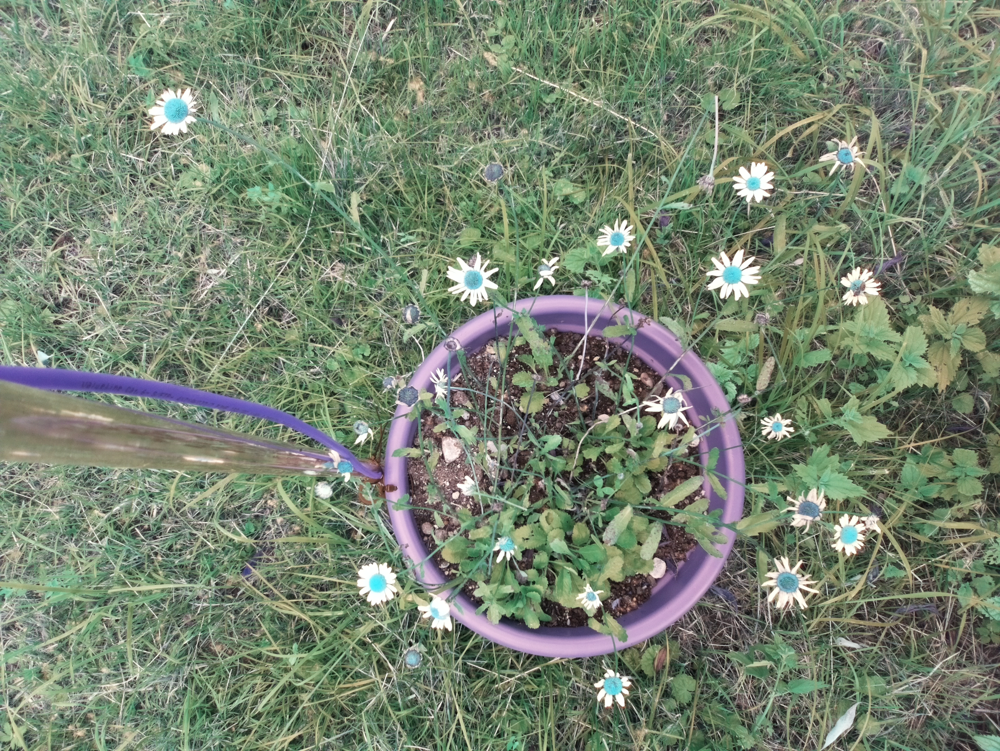

In [2]:
url = "https://tamberg-mac.try.yaler.io/1975-0305_2021-06-27T10-06-06Z.jpg"
image = io.imread(url)
cv2_imshow(image)

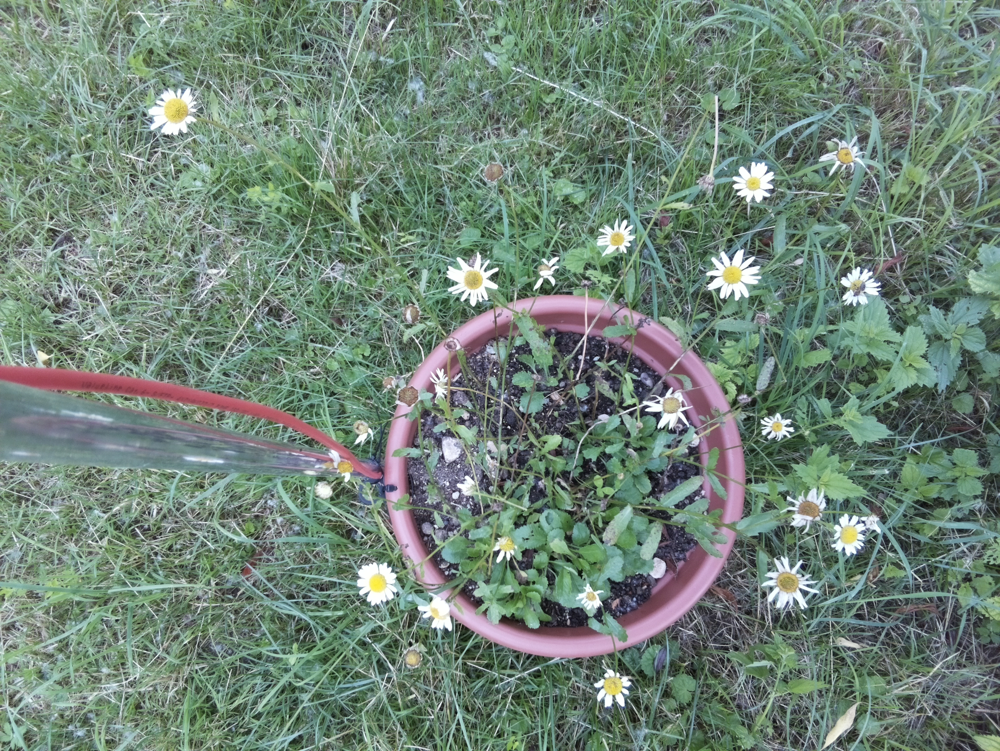

In [3]:
image_rgb = cv.cvtColor(image, cv.COLOR_BGR2RGB)
cv2_imshow(image_rgb)

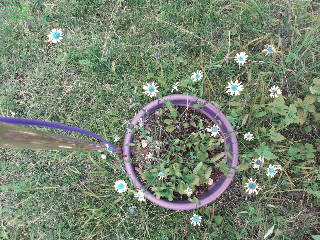

In [65]:
image_320x240 = cv.resize(image, (320, 240))
cv2_imshow(image_320x240)

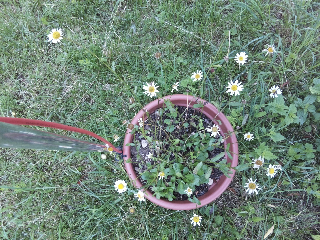

In [5]:
image_320x240_rgb = cv.cvtColor(image_320x240, cv.COLOR_BGR2RGB)
cv2_imshow(image_320x240_rgb)

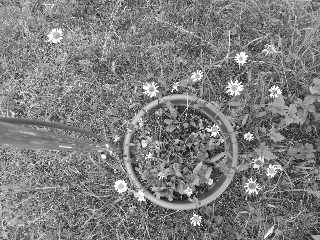

In [7]:
image_320x240_gray = cv.cvtColor(image_320x240, cv.COLOR_BGR2GRAY)
cv2_imshow(image_320x240_gray)

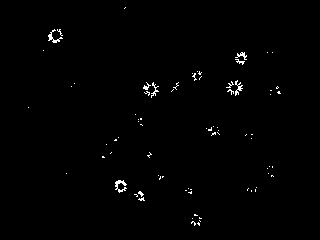

In [19]:
lower = (245, 245, 245)
upper = (255, 255, 255)
image_320x240_mask = cv.inRange(image_320x240, lower, upper)
cv2_imshow(image_320x240_mask)

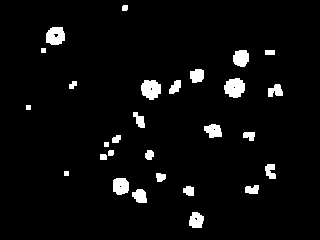

In [59]:
image_320x240_dilated = cv.dilate(image_320x240_mask, None, iterations=2)
cv2_imshow(image_320x240_dilated)

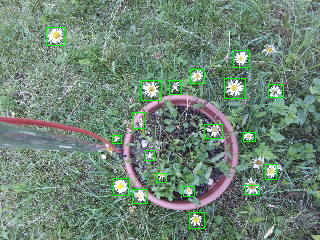

In [67]:
contours, _ = cv.findContours(image_320x240_dilated, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
for contour in contours:
  if cv.contourArea(contour) >= 40:
    (x, y, w, h) = cv.boundingRect(contour)
    cv.rectangle(image_320x240_rgb, (x, y), (x+w, y+h), (0, 255, 0), 1)
cv2_imshow(image_320x240_rgb)